<a href="https://colab.research.google.com/github/electronjia/heart_cardiac_mri_image_processing/blob/main/edge_detection_and_contours/lv_edge_detection_single_pt.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#### Mahri
I will use dicom images because they preserve accurate pixel spacing and temporal ordering that might be needed for ejection fraction and motion tracking.

In [1]:
# On g collab only
!git clone https://github.com/electronjia/heart_cardiac_mri_image_processing.git

Cloning into 'heart_cardiac_mri_image_processing'...
remote: Enumerating objects: 13040, done.
remote: Counting objects: 100% (802/802), done.
remote: Compressing objects: 100% (475/475), done.
remote: Total 13040 (delta 336), reused 760 (delta 327), pack-reused 12238 (from 2)
Receiving objects: 100% (13040/13040), 666.14 MiB | 13.73 MiB/s, done.
Resolving deltas: 100% (922/922), done.
Updating files: 100% (11125/11125), done.


In [2]:
# On g collab only
!pip install pydicom

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 59.7 MB/s eta 0:00:00


In [3]:
# On g collab only
!pwd
!ls -l
%cd heart_cardiac_mri_image_processing/edge_detection_and_contours
!pwd

/content
total 8
drwxr-xr-x 6 root root 4096 Mar 21 16:50 heart_cardiac_mri_image_processing
drwxr-xr-x 1 root root 4096 Mar 20 13:31 sample_data
/content/heart_cardiac_mri_image_processing/edge_detection_and_contours
/content/heart_cardiac_mri_image_processing/edge_detection_and_contours


In [4]:
import pandas as pd
from config import *
import os
import numpy as np
from skimage import exposure, filters, measure, morphology
import matplotlib.pyplot as plt
import pydicom
from skimage import img_as_ubyte
from skimage.feature import canny
from skimage.measure import label, regionprops
import ipywidgets as widgets
from IPython.display import display
from skimage.draw import polygon

In [18]:
# On g collab only
import sys
sys.path.append('/content/heart_cardiac_mri_image_processing/edge_detection_and_contours')
user_handle = r"/content/heart_cardiac_mri_image_processing/data"
patient_data_excel_path = r"/content/heart_cardiac_mri_image_processing/scd_patientdata_xlsx.xlsx"
patient_data = "patient_data"
patient_filepaths = "patient_filepaths"

user_handle_g_collab = "/content/heart_cardiac_mri_image_processing/data"

Read the excel file with patient filepaths to start processing

In [6]:
patient_xlsx = patient_data_excel_path
patient_data_df = pd.read_excel(patient_xlsx, sheet_name=patient_data)
patient_filepaths_df = pd.read_excel(patient_xlsx, sheet_name=patient_filepaths)
patient_mask_filepaths = pd.read_excel(patient_xlsx, sheet_name="mask_filepaths")

display(patient_data_df.head(2))
display(patient_filepaths_df.head(2))

,patient_id,original_id,gender,age,pathology,filepath,gif_filepath
0,SCD0000101,SC-HF-I-1,Male,53,Heart failure with infarct,SCD_IMAGES_01\SCD0000101\CINESAX_300,SCD_IMAGES_01\SCD0000101\SCD0000101_gif.gif
1,SCD0000201,SC-HF-I-2,Male,48,Heart failure with infarct,SCD_IMAGES_01\SCD0000201\CINESAX_300,SCD_IMAGES_01\SCD0000201\SCD0000201_gif.gif


,patient_id,dcm_image_filepath
0,SCD0000101,SCD_IMAGES_01\SCD0000101\CINESAX_300\IM-0003-0...
1,SCD0000101,SCD_IMAGES_01\SCD0000101\CINESAX_300\IM-0003-0...


# Experiment with one patient

Conversion to single grayscale in case the dicom cine short axis mri images are not single channel grayscale type

In [16]:
# Single patient

patient_ids = patient_filepaths_df['patient_id'].unique()
patient_id = patient_ids[0]
single_patient_filepaths = patient_filepaths_df.loc[patient_filepaths_df['patient_id'] == patient_id, 'dcm_image_filepath'].tolist()


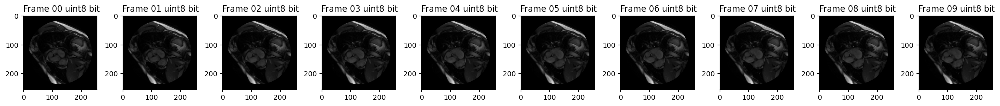

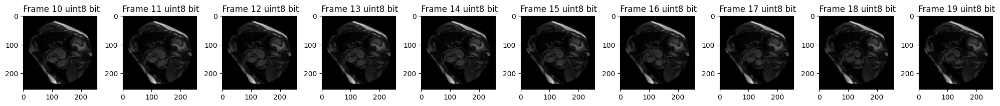

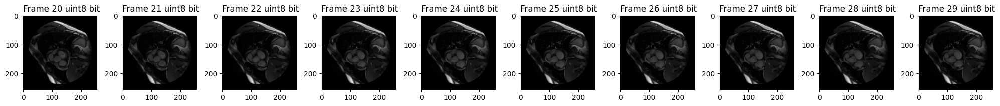

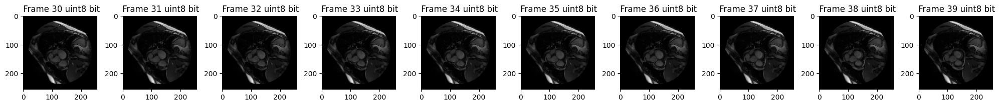

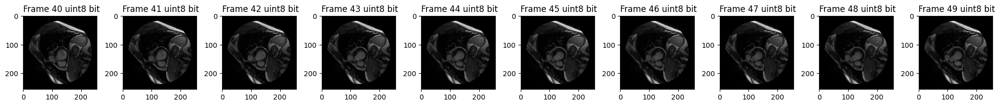

...

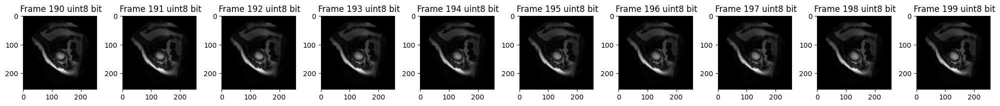

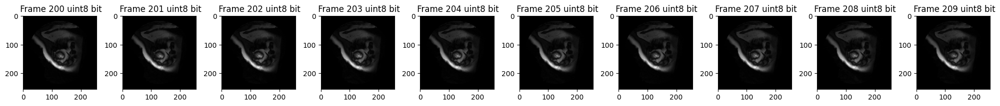

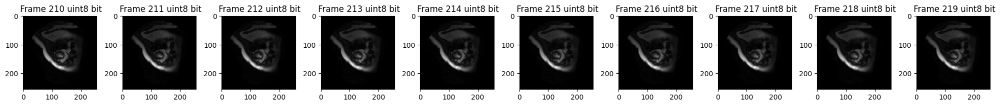

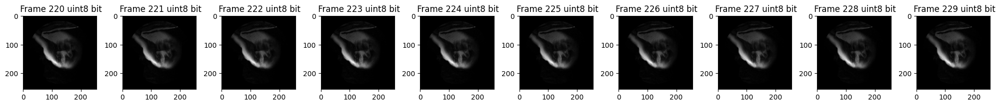

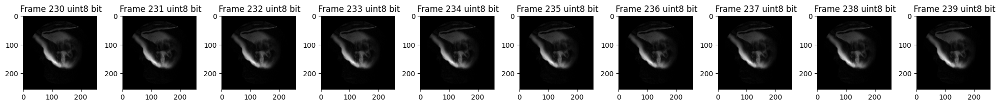

In [29]:
num_cols = 10  # Number of images per row

# Process images in batches of 10
for batch_idx, batch_start in enumerate(range(0, len(single_patient_filepaths), num_cols)):
    batch_filepaths = single_patient_filepaths[batch_start:batch_start + num_cols]
    num_images = len(batch_filepaths)

    fig, axes = plt.subplots(1, num_images, figsize=(num_images * 2, 4))
    if num_images == 1:
        axes = [axes]  # Ensure axes is iterable when there's only one image

    for idx, img_ex_filepath in enumerate(batch_filepaths):
        # For Google Colab only
        img_ex_filepath = img_ex_filepath.replace("\\", "/")
        img_abs_filepath = os.path.join(user_handle_g_collab, img_ex_filepath)

        # Read the DICOM image
        dicom_image = pydicom.dcmread(img_abs_filepath)

        # Extract the pixel data and convert to 8-bit image
        image = img_as_ubyte(dicom_image.pixel_array / np.max(dicom_image.pixel_array))

        # Plot processed image
        axes[idx].imshow(image, cmap="gray", vmin=np.min(image), vmax=np.max(image))
        axes[idx].set(title=f" Frame {batch_idx}{idx} {image.dtype} bit")

    plt.tight_layout()
    plt.show()

In [31]:
# Optimal parameters
disk_size = 1
sigma_blur = 0.2
clip_limit_val = 0.03
sigma_edge = 7.00
level_val = 0.7

Filter out the noise from the image using gaussian or median filters

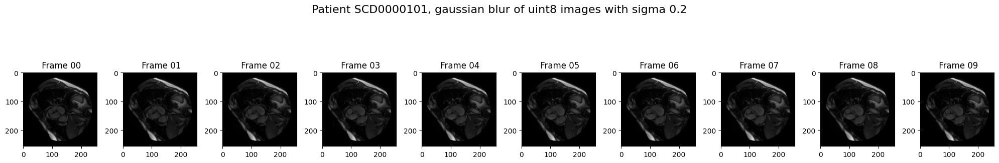

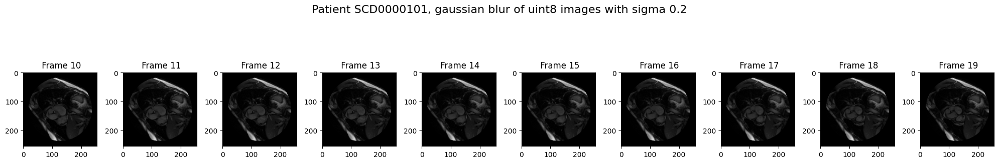

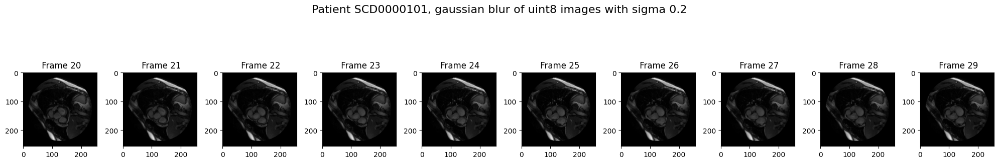

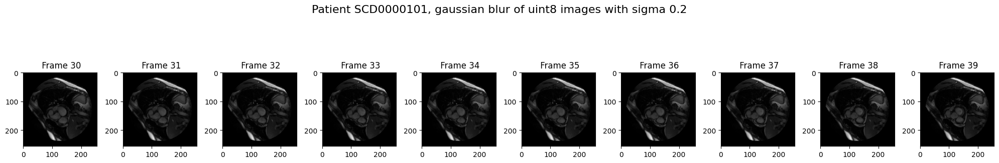

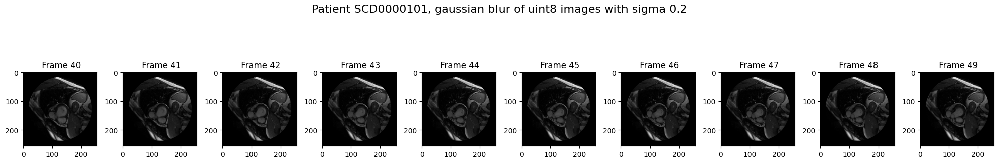

...

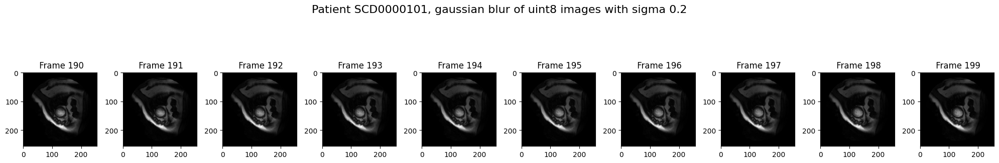

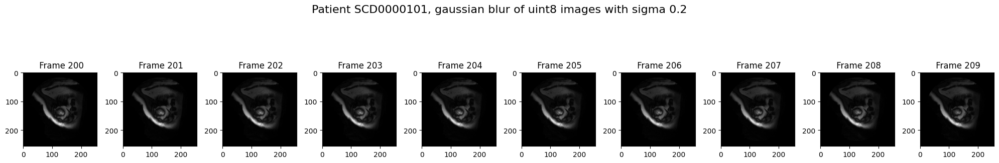

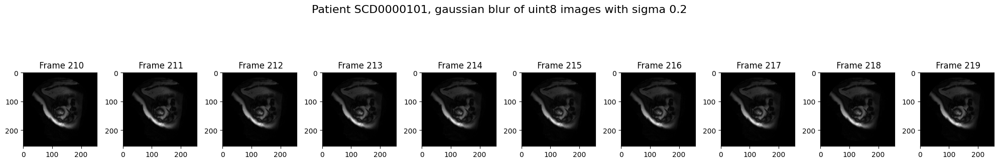

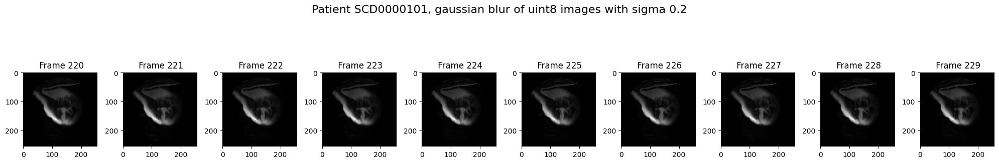

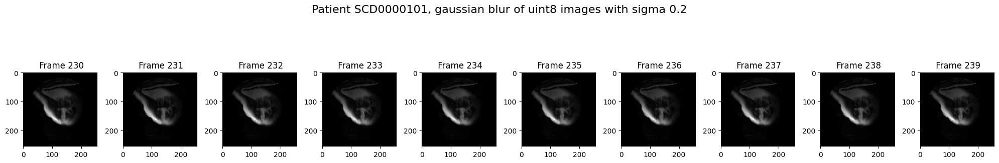

In [34]:
num_cols = 10  # Number of images per row

# Process images in batches of 10
for batch_idx, batch_start in enumerate(range(0, len(single_patient_filepaths), num_cols)):
    batch_filepaths = single_patient_filepaths[batch_start:batch_start + num_cols]
    num_images = len(batch_filepaths)

    fig, axes = plt.subplots(1, num_images, figsize=(num_images * 2, 4))
    if num_images == 1:
        axes = [axes]  # Ensure axes is iterable when there's only one image

    for idx, img_ex_filepath in enumerate(batch_filepaths):
        # For Google Colab only
        img_ex_filepath = img_ex_filepath.replace("\\", "/")
        img_abs_filepath = os.path.join(user_handle_g_collab, img_ex_filepath)

        # Read the DICOM image
        dicom_image = pydicom.dcmread(img_abs_filepath)

        # Extract the pixel data and convert to 8-bit image
        image = img_as_ubyte(dicom_image.pixel_array / np.max(dicom_image.pixel_array))

        # Apply gaussian filter
        image_blurred_gaus = filters.gaussian(image, sigma=sigma_blur)

        # Plot processed image
        axes[idx].imshow(image_blurred_gaus, cmap="gray", vmin=np.min(image_blurred_gaus), vmax=np.max(image_blurred_gaus))
        axes[idx].set(title=f" Frame {batch_idx}{idx}")

    plt.suptitle(f"Patient {patient_id}, gaussian blur of uint8 images with sigma {sigma_blur}", fontsize=16)
    plt.tight_layout()
    plt.show()



Enhance contract using CLAHE (contrast limited adaptive histogram equalization)

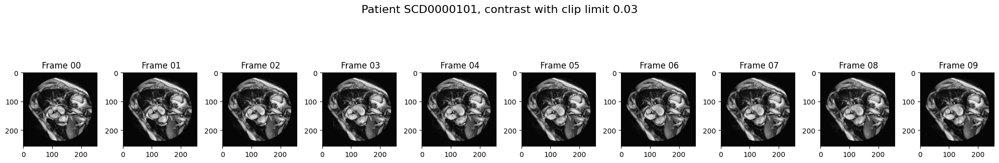

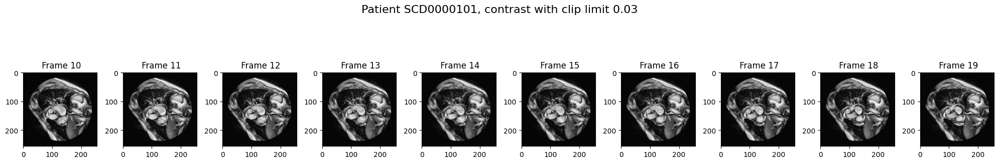

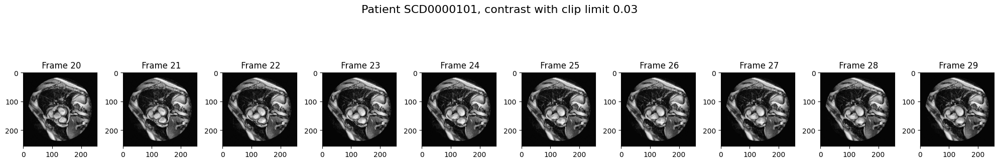

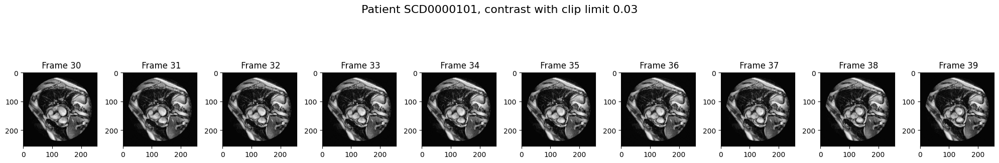

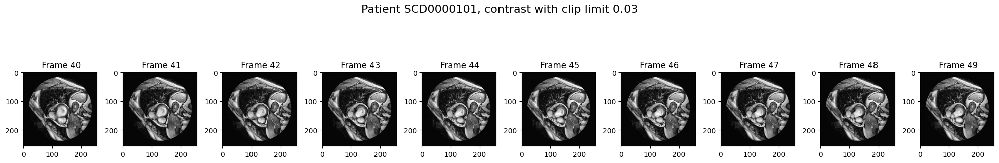

...

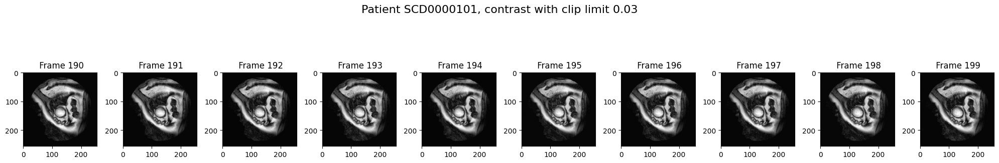

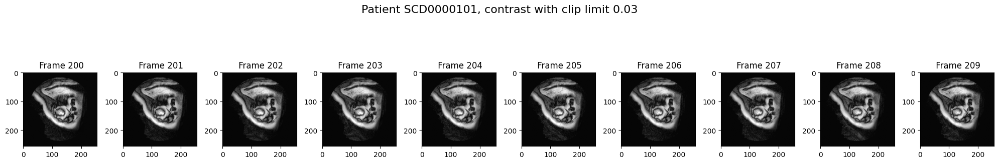

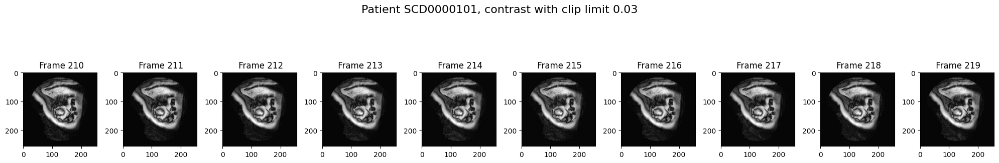

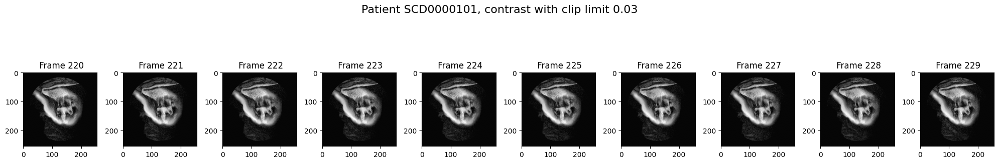

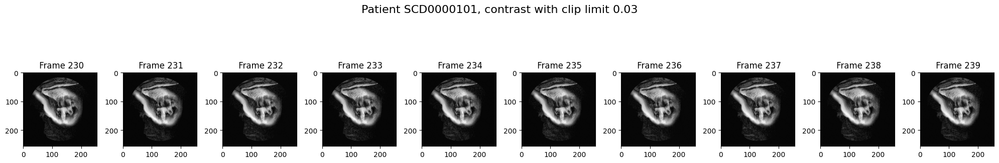

In [35]:

num_cols = 10  # Number of images per row

# Process images in batches of 10
for batch_idx, batch_start in enumerate(range(0, len(single_patient_filepaths), num_cols)):
    batch_filepaths = single_patient_filepaths[batch_start:batch_start + num_cols]
    num_images = len(batch_filepaths)

    fig, axes = plt.subplots(1, num_images, figsize=(num_images * 2, 4))
    if num_images == 1:
        axes = [axes]  # Ensure axes is iterable when there's only one image

    for idx, img_ex_filepath in enumerate(batch_filepaths):
        # For Google Colab only
        img_ex_filepath = img_ex_filepath.replace("\\", "/")
        img_abs_filepath = os.path.join(user_handle_g_collab, img_ex_filepath)

        # Read the DICOM image
        dicom_image = pydicom.dcmread(img_abs_filepath)

        # Extract the pixel data and convert to 8-bit image
        image = img_as_ubyte(dicom_image.pixel_array / np.max(dicom_image.pixel_array))

        # Apply gaussian filter
        image_blurred_gaus = filters.gaussian(image, sigma=sigma_blur)

        # Apply contrast
        img_contrast_gaus = exposure.equalize_adapthist(image_blurred_gaus, clip_limit=clip_limit_val)

        # Plot processed image
        axes[idx].imshow(img_contrast_gaus, cmap="gray", vmin=np.min(img_contrast_gaus), vmax=np.max(img_contrast_gaus))
        axes[idx].set(title=f" Frame {batch_idx}{idx}")

    plt.suptitle(f"Patient {patient_id}, contrast with clip limit {clip_limit_val}", fontsize=16)
    plt.tight_layout()
    plt.show()

As we can see in the above results, both gaussian and median filters provide good results. I will continue with gaussian filtering.

Edge detection with Canny function

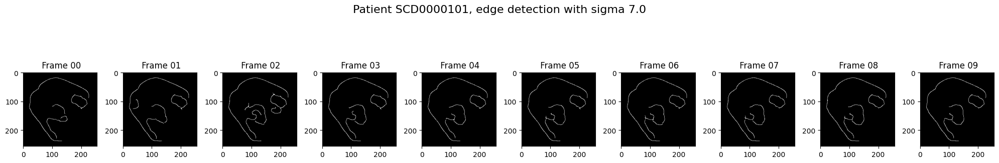

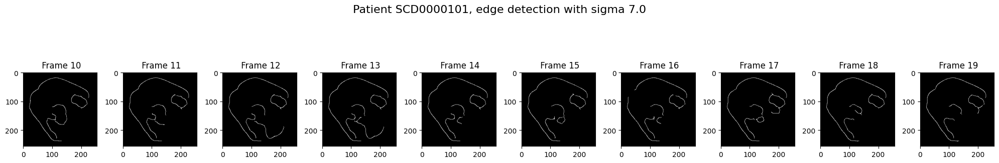

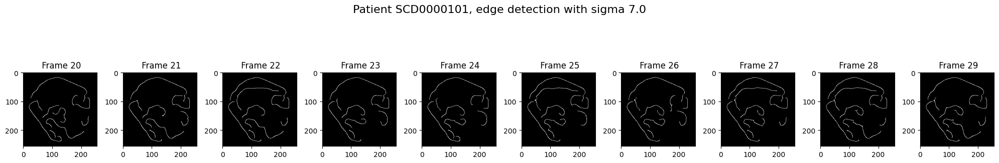

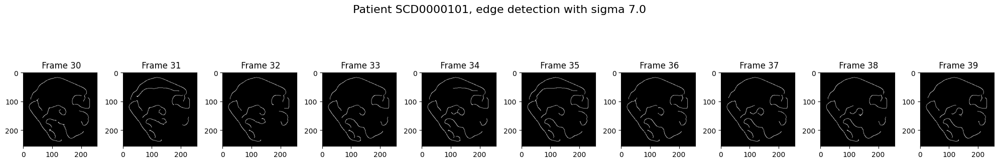

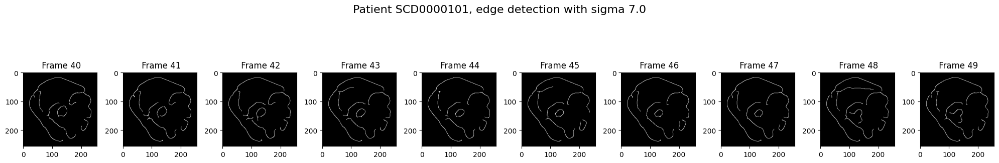

...

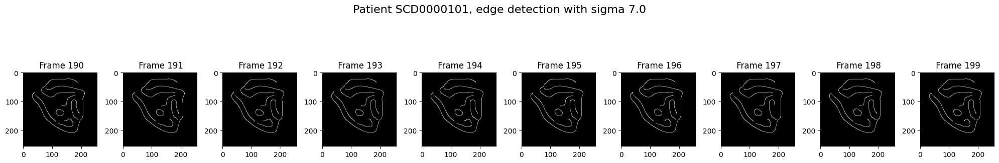

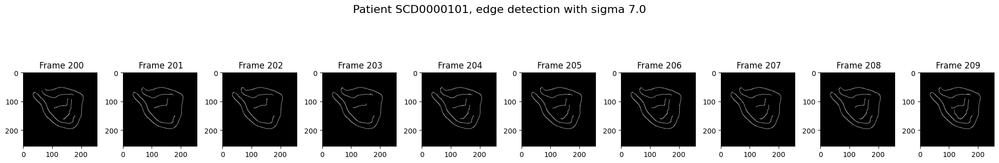

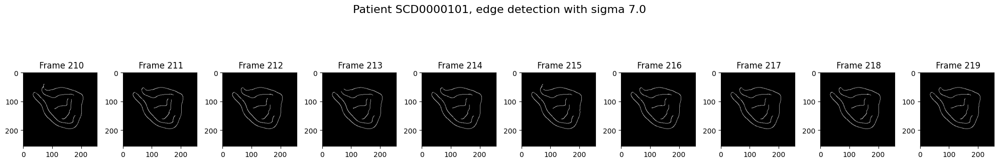

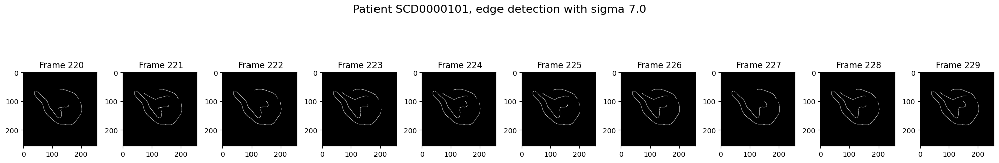

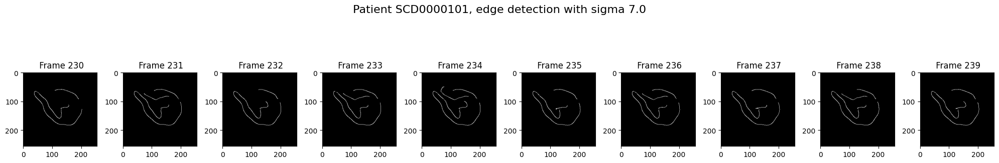

In [36]:

num_cols = 10  # Number of images per row

# Process images in batches of 10
for batch_idx, batch_start in enumerate(range(0, len(single_patient_filepaths), num_cols)):
    batch_filepaths = single_patient_filepaths[batch_start:batch_start + num_cols]
    num_images = len(batch_filepaths)

    fig, axes = plt.subplots(1, num_images, figsize=(num_images * 2, 4))
    if num_images == 1:
        axes = [axes]  # Ensure axes is iterable when there's only one image

    for idx, img_ex_filepath in enumerate(batch_filepaths):
        # For Google Colab only
        img_ex_filepath = img_ex_filepath.replace("\\", "/")
        img_abs_filepath = os.path.join(user_handle_g_collab, img_ex_filepath)

        # Read the DICOM image
        dicom_image = pydicom.dcmread(img_abs_filepath)

        # Extract the pixel data and convert to 8-bit image
        image = img_as_ubyte(dicom_image.pixel_array / np.max(dicom_image.pixel_array))

        # Apply gaussian filter
        image_blurred_gaus = filters.gaussian(image, sigma=sigma_blur)

        # Apply contrast
        img_contrast_gaus = exposure.equalize_adapthist(image_blurred_gaus, clip_limit=clip_limit_val)

        # Edge detection
        edges_gaus = canny(img_contrast_gaus, sigma=sigma_edge)

        # Plot processed image
        axes[idx].imshow(edges_gaus, cmap="gray", vmin=np.min(edges_gaus), vmax=np.max(edges_gaus))
        axes[idx].set(title=f" Frame {batch_idx}{idx}")

    plt.suptitle(f"Patient {patient_id}, edge detection with sigma {sigma_edge}", fontsize=16)
    plt.tight_layout()
    plt.show()


Find and draw the contours

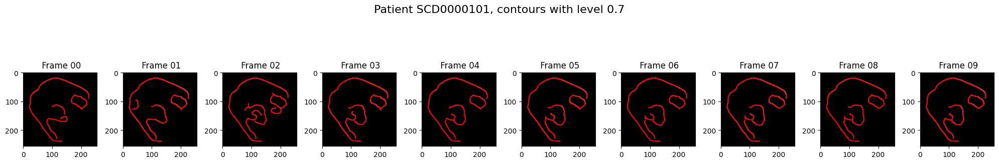

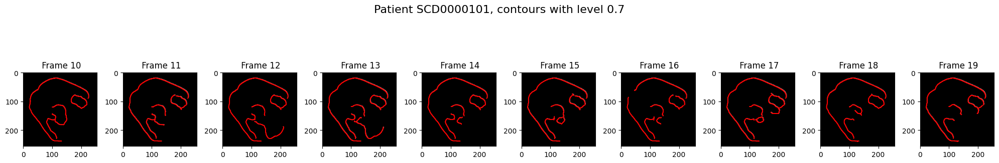

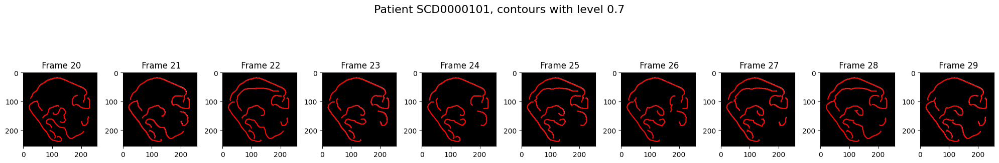

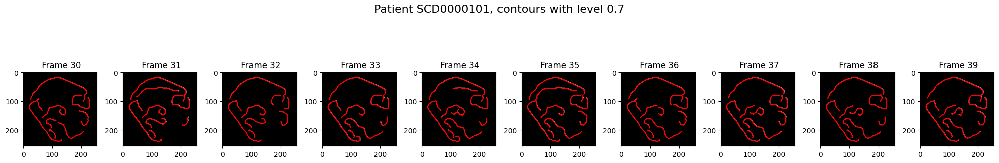

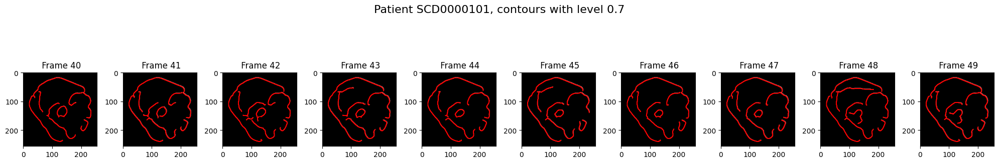

...

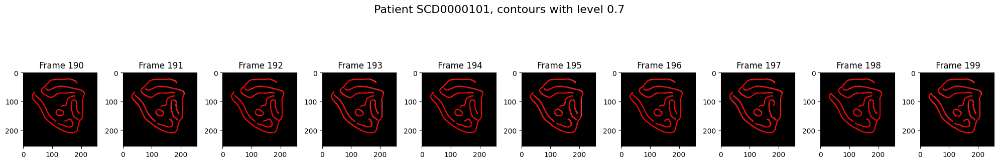

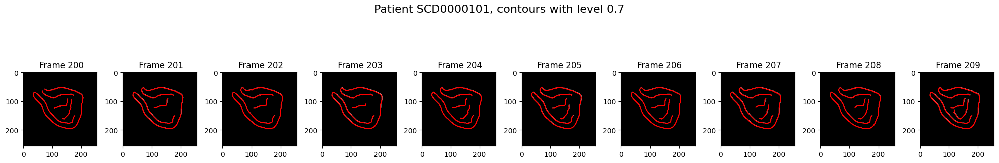

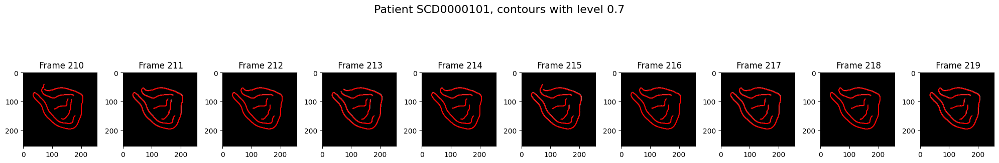

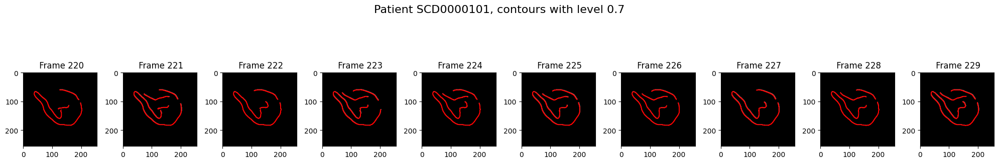

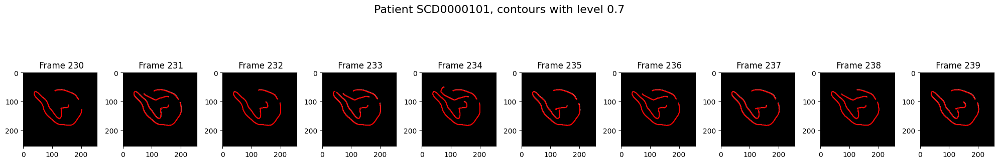

In [38]:

num_cols = 10  # Number of images per row

# Process images in batches of 10
for batch_idx, batch_start in enumerate(range(0, len(single_patient_filepaths), num_cols)):
    batch_filepaths = single_patient_filepaths[batch_start:batch_start + num_cols]
    num_images = len(batch_filepaths)

    fig, axes = plt.subplots(1, num_images, figsize=(num_images * 2, 4))
    if num_images == 1:
        axes = [axes]  # Ensure axes is iterable when there's only one image

    for idx, img_ex_filepath in enumerate(batch_filepaths):
        # For Google Colab only
        img_ex_filepath = img_ex_filepath.replace("\\", "/")
        img_abs_filepath = os.path.join(user_handle_g_collab, img_ex_filepath)

        # Read the DICOM image
        dicom_image = pydicom.dcmread(img_abs_filepath)

        # Extract the pixel data and convert to 8-bit image
        image = img_as_ubyte(dicom_image.pixel_array / np.max(dicom_image.pixel_array))

        # Apply gaussian filter
        image_blurred_gaus = filters.gaussian(image, sigma=sigma_blur)

        # Apply contrast
        img_contrast_gaus = exposure.equalize_adapthist(image_blurred_gaus, clip_limit=clip_limit_val)

        # Edge detection
        edges_gaus = canny(img_contrast_gaus, sigma=sigma_edge)

        # Find and draw contours
        contours = measure.find_contours(edges_gaus, level=level_val)

        # Plot processed image
        axes[idx].imshow(edges_gaus, cmap="gray", vmin=np.min(edges_gaus), vmax=np.max(edges_gaus))

        for contour in contours:
            axes[idx].plot(contour[:, 1], contour[:, 0], color='r', linewidth=1)  # Plot contours

        axes[idx].set(title=f" Frame {batch_idx}{idx}")

    plt.suptitle(f"Patient {patient_id}, contours with level {level_val}", fontsize=16)
    plt.tight_layout()
    plt.show()

As we can see, the ventricle does get enclosed but there are a lot of other things as well. I will try to extract the circles in the edge detected image.

Create a binary mask with contours being at the foreground

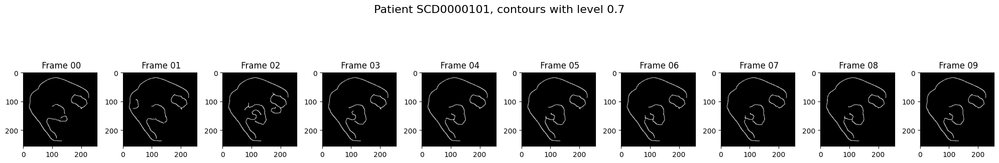

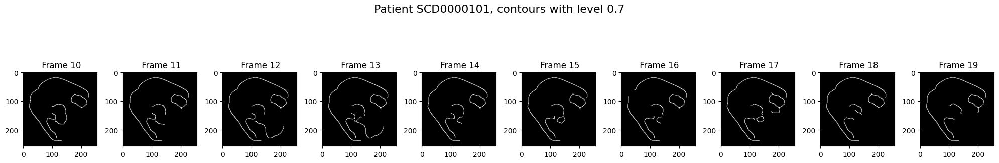

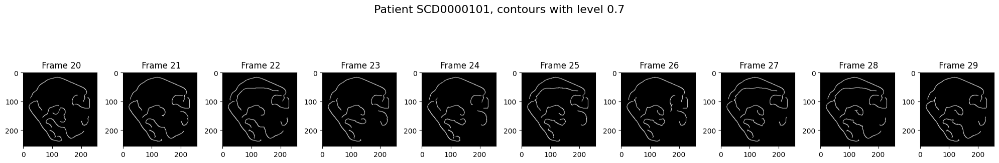

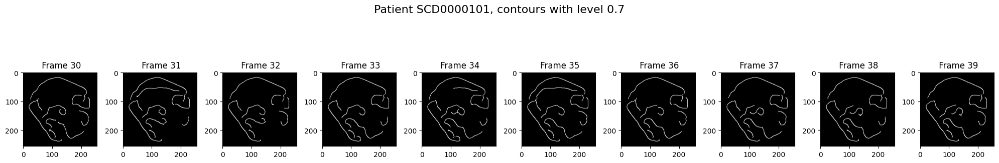

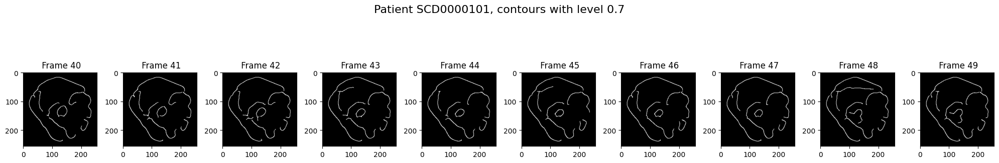

...

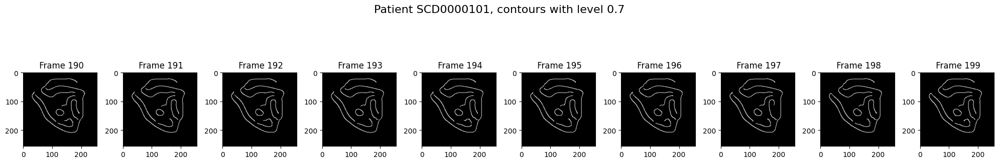

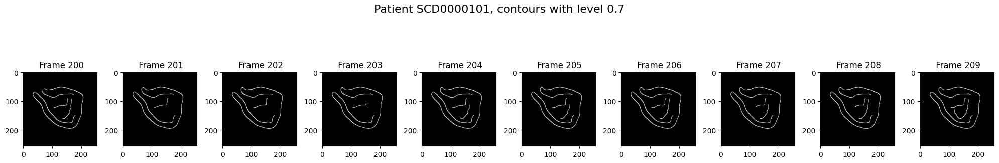

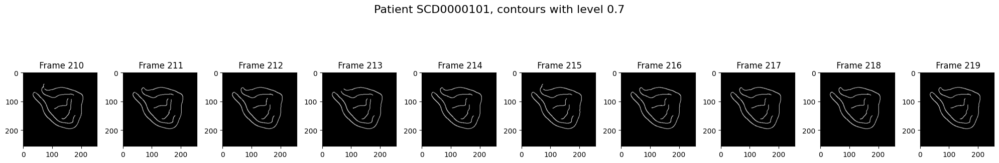

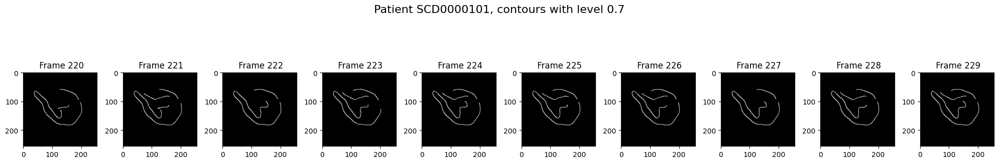

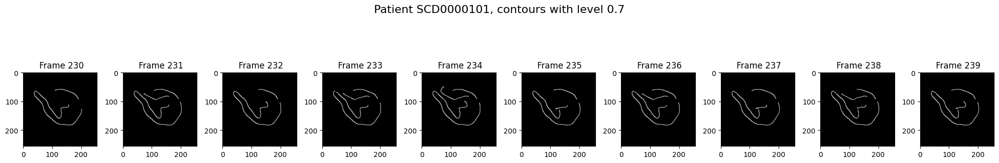

In [39]:

num_cols = 10  # Number of images per row

# Process images in batches of 10
for batch_idx, batch_start in enumerate(range(0, len(single_patient_filepaths), num_cols)):
    batch_filepaths = single_patient_filepaths[batch_start:batch_start + num_cols]
    num_images = len(batch_filepaths)

    fig, axes = plt.subplots(1, num_images, figsize=(num_images * 2, 4))
    if num_images == 1:
        axes = [axes]  # Ensure axes is iterable when there's only one image

    for idx, img_ex_filepath in enumerate(batch_filepaths):
        # For Google Colab only
        img_ex_filepath = img_ex_filepath.replace("\\", "/")
        img_abs_filepath = os.path.join(user_handle_g_collab, img_ex_filepath)

        # Read the DICOM image
        dicom_image = pydicom.dcmread(img_abs_filepath)

        # Extract the pixel data and convert to 8-bit image
        image = img_as_ubyte(dicom_image.pixel_array / np.max(dicom_image.pixel_array))

        # Apply gaussian filter
        image_blurred_gaus = filters.gaussian(image, sigma=sigma_blur)

        # Apply contrast
        img_contrast_gaus = exposure.equalize_adapthist(image_blurred_gaus, clip_limit=clip_limit_val)

        # Edge detection
        edges_gaus = canny(img_contrast_gaus, sigma=sigma_edge)

        # Find and draw contours
        contours = measure.find_contours(edges_gaus, level=level_val)

        # Create a binary mask with contours
        binary_contours_image = np.zeros_like(image, dtype=np.uint8)
        for contour in contours:
            # Convert contour to polygon coordinates and fill it in the binary image
            contour_points = contour.astype(int)
            rr, cc = polygon(contour_points[:, 0], contour_points[:, 1], shape=binary_contours_image.shape)
            binary_contours_image[rr, cc] = 255  # Set contour area to foreground (255)

        # Plot processed image
        axes[idx].imshow(edges_gaus, cmap="gray", vmin=np.min(edges_gaus), vmax=np.max(edges_gaus))
        axes[idx].imshow(binary_contours_image, cmap="gray", alpha=0.5)  # Overlay contours on the image
        axes[idx].set(title=f" Frame {batch_idx}{idx}")

    plt.suptitle(f"Patient {patient_id}, contours with level {level_val}", fontsize=16)
    plt.tight_layout()
    plt.show()

I will find labels in the binary mask, measure region properties and evaluate eccentricity of every region.

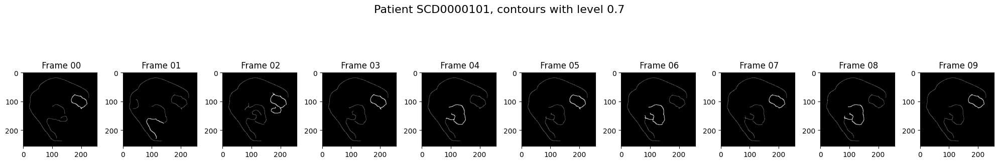

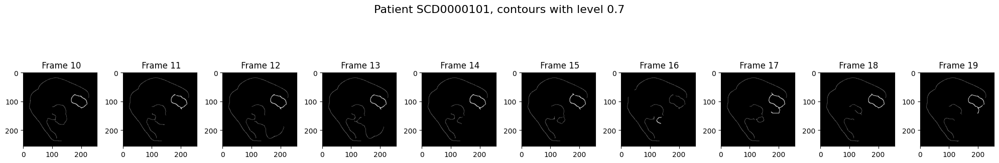

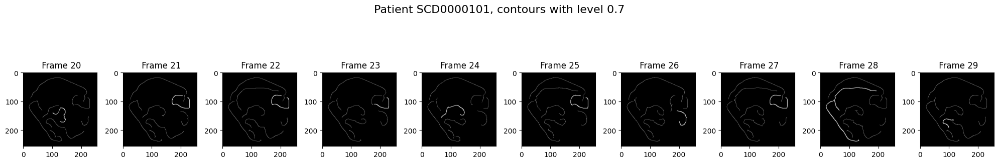

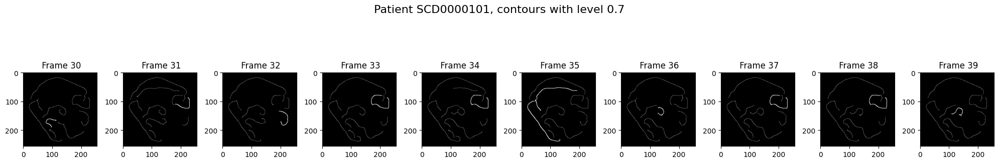

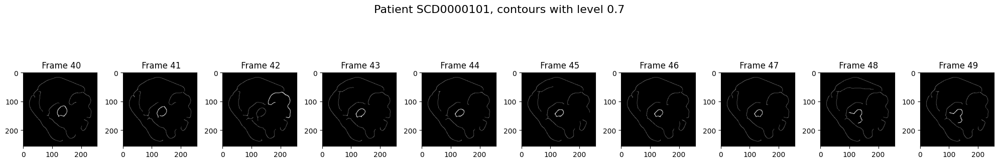

...

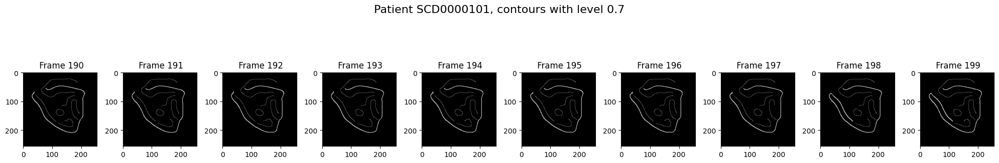

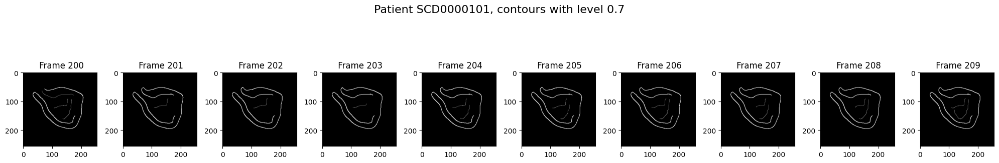

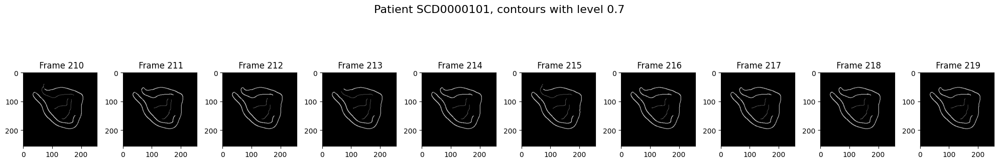

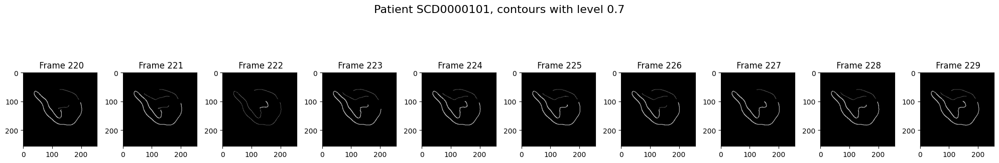

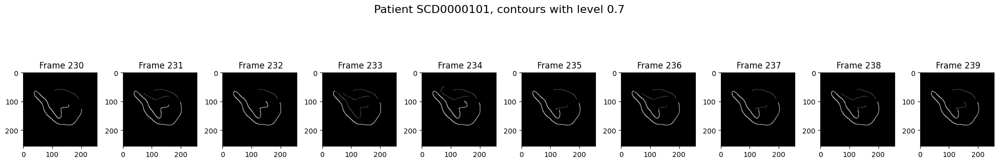

In [40]:

num_cols = 10  # Number of images per row

# Process images in batches of 10
for batch_idx, batch_start in enumerate(range(0, len(single_patient_filepaths), num_cols)):
    batch_filepaths = single_patient_filepaths[batch_start:batch_start + num_cols]
    num_images = len(batch_filepaths)

    fig, axes = plt.subplots(1, num_images, figsize=(num_images * 2, 4))
    if num_images == 1:
        axes = [axes]  # Ensure axes is iterable when there's only one image

    for idx, img_ex_filepath in enumerate(batch_filepaths):
        # For Google Colab only
        img_ex_filepath = img_ex_filepath.replace("\\", "/")
        img_abs_filepath = os.path.join(user_handle_g_collab, img_ex_filepath)

        # Read the DICOM image
        dicom_image = pydicom.dcmread(img_abs_filepath)

        # Extract the pixel data and convert to 8-bit image
        image = img_as_ubyte(dicom_image.pixel_array / np.max(dicom_image.pixel_array))

        # Apply gaussian filter
        image_blurred_gaus = filters.gaussian(image, sigma=sigma_blur)

        # Apply contrast
        img_contrast_gaus = exposure.equalize_adapthist(image_blurred_gaus, clip_limit=clip_limit_val)

        # Edge detection
        edges_gaus = canny(img_contrast_gaus, sigma=sigma_edge)

        # Find and draw contours
        contours = measure.find_contours(edges_gaus, level=level_val)

        # Create a binary mask with contours
        binary_contours_image = np.zeros_like(image, dtype=np.uint8)
        for contour in contours:
            # Convert contour to polygon coordinates and fill it in the binary image
            contour_points = contour.astype(int)
            rr, cc = polygon(contour_points[:, 0], contour_points[:, 1], shape=binary_contours_image.shape)
            binary_contours_image[rr, cc] = 255  # Set contour area to foreground (255)


        # Find the labels in binary mask
        labeled_image, num_labels = measure.label(binary_contours_image, connectivity=2, return_num=True)

        # Measure region properties
        regions = measure.regionprops(labeled_image)

        # Find smallest eccentricity
        smallest_eccentricity = float('inf')
        smallest_eccentricity_region = None

        for prop in regions:
            if prop.eccentricity < smallest_eccentricity:
                smallest_eccentricity = prop.eccentricity
                smallest_eccentricity_region = prop


        # Create a mask for smallest eccentricity region

        smallest_eccentricity_mask = np.zeros_like(labeled_image, dtype=np.uint8)
        smallest_eccentricity_mask[labeled_image == smallest_eccentricity_region.label] = 255

        # Plot processed image
        axes[idx].imshow(edges_gaus, cmap="gray", vmin=np.min(edges_gaus), vmax=np.max(edges_gaus))
        axes[idx].imshow(smallest_eccentricity_mask, cmap="gray", alpha=0.4)  # Overlay contours on the image
        axes[idx].set(title=f" Frame {batch_idx}{idx}")

    plt.suptitle(f"Patient {patient_id}, contours with level {level_val}", fontsize=16)
    plt.tight_layout()
    plt.show()


Using smallest eccentricity, which should coincide with left ventricle, let's obtain the mask for the left ventricle

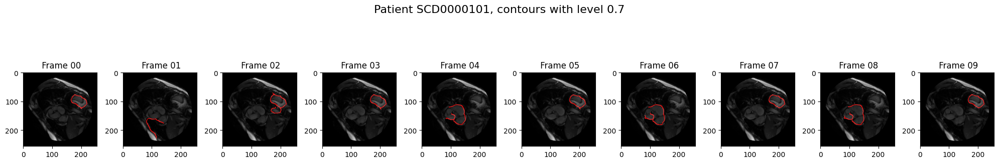

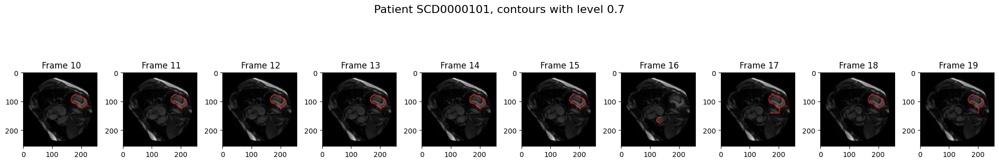

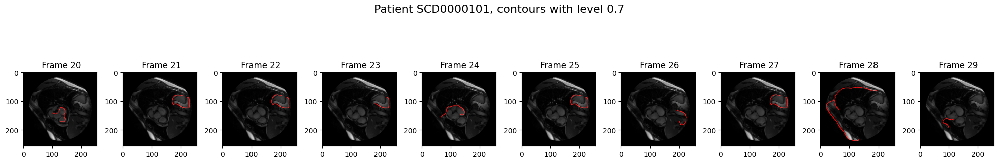

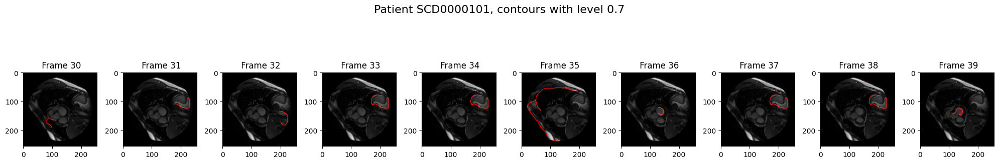

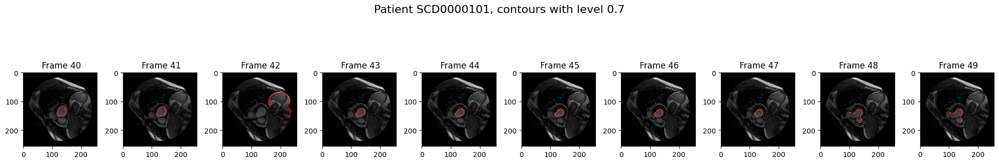

...

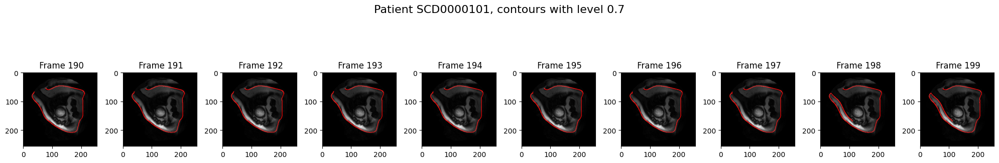

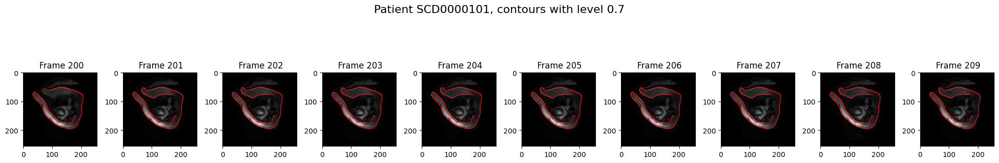

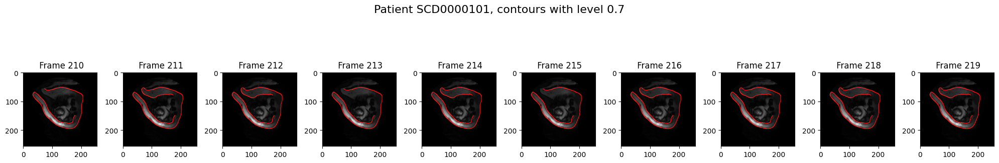

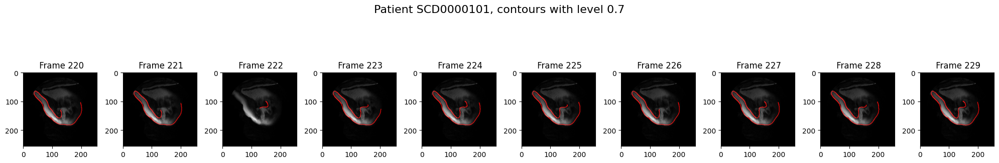

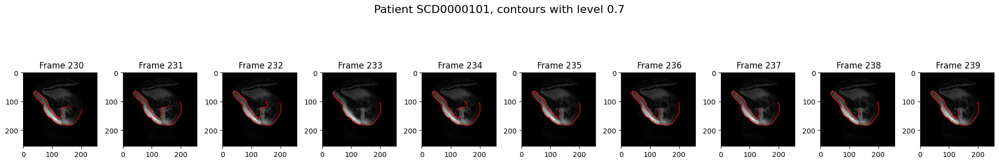

In [42]:


num_cols = 10  # Number of images per row

# Process images in batches of 10
for batch_idx, batch_start in enumerate(range(0, len(single_patient_filepaths), num_cols)):
    batch_filepaths = single_patient_filepaths[batch_start:batch_start + num_cols]
    num_images = len(batch_filepaths)

    fig, axes = plt.subplots(1, num_images, figsize=(num_images * 2, 4))
    if num_images == 1:
        axes = [axes]  # Ensure axes is iterable when there's only one image

    for idx, img_ex_filepath in enumerate(batch_filepaths):
        # For Google Colab only
        img_ex_filepath = img_ex_filepath.replace("\\", "/")
        img_abs_filepath = os.path.join(user_handle_g_collab, img_ex_filepath)

        # Read the DICOM image
        dicom_image = pydicom.dcmread(img_abs_filepath)

        # Extract the pixel data and convert to 8-bit image
        image = img_as_ubyte(dicom_image.pixel_array / np.max(dicom_image.pixel_array))

        # Apply gaussian filter
        image_blurred_gaus = filters.gaussian(image, sigma=sigma_blur)

        # Apply contrast
        img_contrast_gaus = exposure.equalize_adapthist(image_blurred_gaus, clip_limit=clip_limit_val)

        # Edge detection
        edges_gaus = canny(img_contrast_gaus, sigma=sigma_edge)

        # Find and draw contours
        contours = measure.find_contours(edges_gaus, level=level_val)

        # Create a binary mask with contours
        binary_contours_image = np.zeros_like(image, dtype=np.uint8)
        for contour in contours:
            # Convert contour to polygon coordinates and fill it in the binary image
            contour_points = contour.astype(int)
            rr, cc = polygon(contour_points[:, 0], contour_points[:, 1], shape=binary_contours_image.shape)
            binary_contours_image[rr, cc] = 255  # Set contour area to foreground (255)


        # Find the labels in binary mask
        labeled_image, num_labels = measure.label(binary_contours_image, connectivity=2, return_num=True)

        # Measure region properties
        regions = measure.regionprops(labeled_image)

        # Find smallest eccentricity
        smallest_eccentricity = float('inf')
        smallest_eccentricity_region = None

        for prop in regions:
            if prop.eccentricity < smallest_eccentricity:
                smallest_eccentricity = prop.eccentricity
                smallest_eccentricity_region = prop


        # Create a mask for smallest eccentricity region
        smallest_eccentricity_mask = np.zeros_like(labeled_image, dtype=np.uint8)
        smallest_eccentricity_mask[labeled_image == smallest_eccentricity_region.label] = 255


        # Plot the overlay
        # Normalize original image for proper display (optional)
        image = image.astype(np.float32)
        image = (image - image.min()) / (image.max() - image.min())  # Normalize to [0,1] range

        # Create an RGB version of the grayscale image
        image_rgb = np.stack([image] * 3, axis=-1)  # Convert grayscale to RGB (shape: HxWx3)

        # Create a red-colored mask (overlay will be red where the mask is)
        mask_rgb = np.zeros_like(image_rgb)  # Create an empty RGB image
        mask_rgb[:, :, 0] = smallest_eccentricity_mask  # Red channel

        # Alpha blending
        alpha = 0.05  # Transparency level
        overlay = (image_rgb * (1 - alpha) + mask_rgb * alpha)

        # Ensure values are in valid range [0,1] for display
        overlay = np.clip(overlay, 0, 1)

        # Plot processed image
        axes[idx].imshow(overlay, cmap="gray", vmin=np.min(overlay), vmax=np.max(overlay))
        axes[idx].set(title=f" Frame {batch_idx}{idx}")

    plt.suptitle(f"Patient {patient_id}, contours with level {level_val}", fontsize=16)
    plt.tight_layout()
    plt.show()


Consider 16 bit
Haft transform
Temporal component by subtracting consecutive frames from each other